<a href="https://colab.research.google.com/github/dharsha454/Test-documents/blob/main/Model_saved_weights.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

In [ ]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

In [ ]:
!sudo apt install tesseract-ocr
!pip install pytesseract

In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

In [ ]:
!curl -L "https://app.roboflow.com/ds/TNlXpBYfKJ?key=IbgBLkmfBw" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

WARNING [05/24 10:39:40 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/24 10:39:40 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/train/_annotations.coco.json


In [8]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

In [9]:
from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

In [16]:
test_metadata = MetadataCatalog.get("my_dataset_test")

In [12]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

In [14]:

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = os.path.join("/content/drive/MyDrive/Saved Models-colab/output", "model_final.pth")
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.MAX_ITER = 1500
cfg.MODEL.ROI_HEADS.NUM_CLASSES =4 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.MODEL.DEVICE = "cpu"
predictor = DefaultPredictor(cfg)


In [22]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train").set(thing_classes=['field', 'field', 'patient_details', 'test_name'])

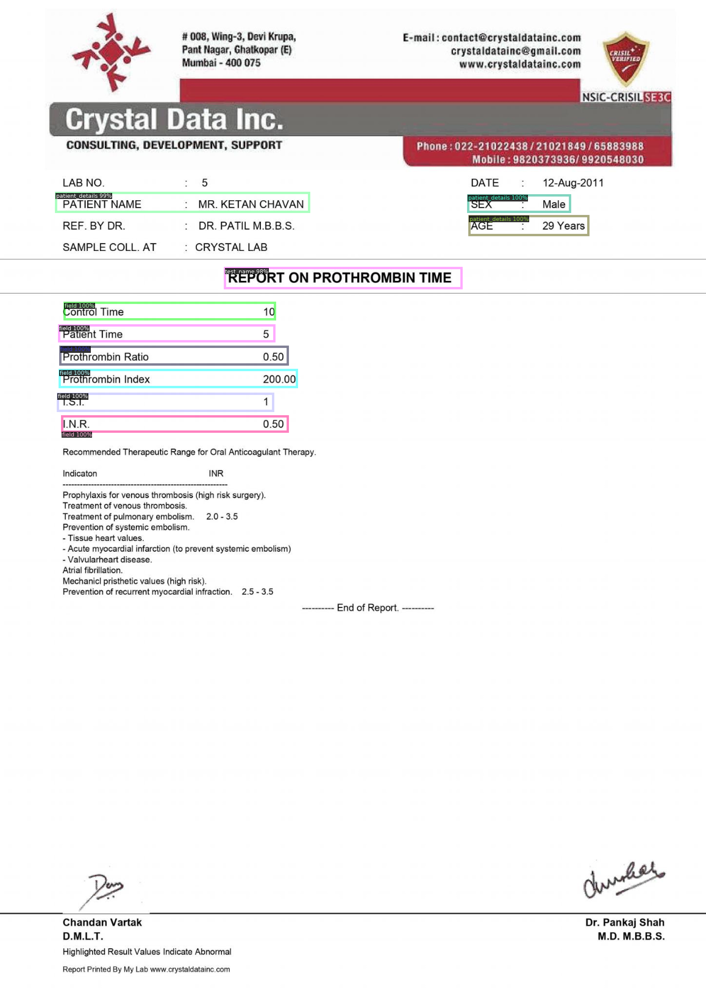

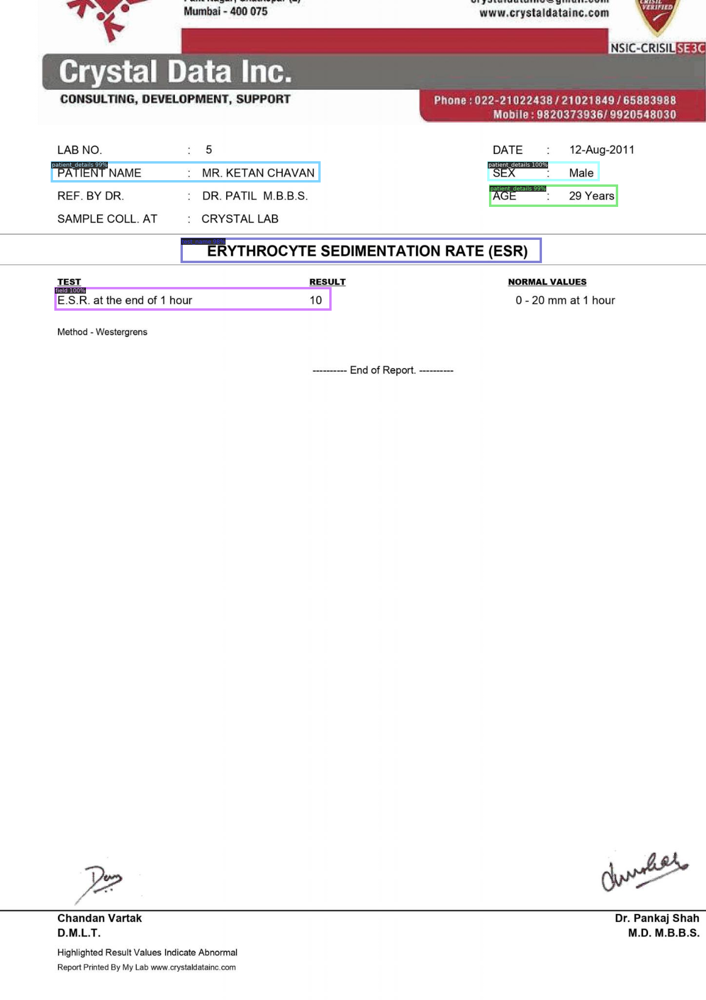

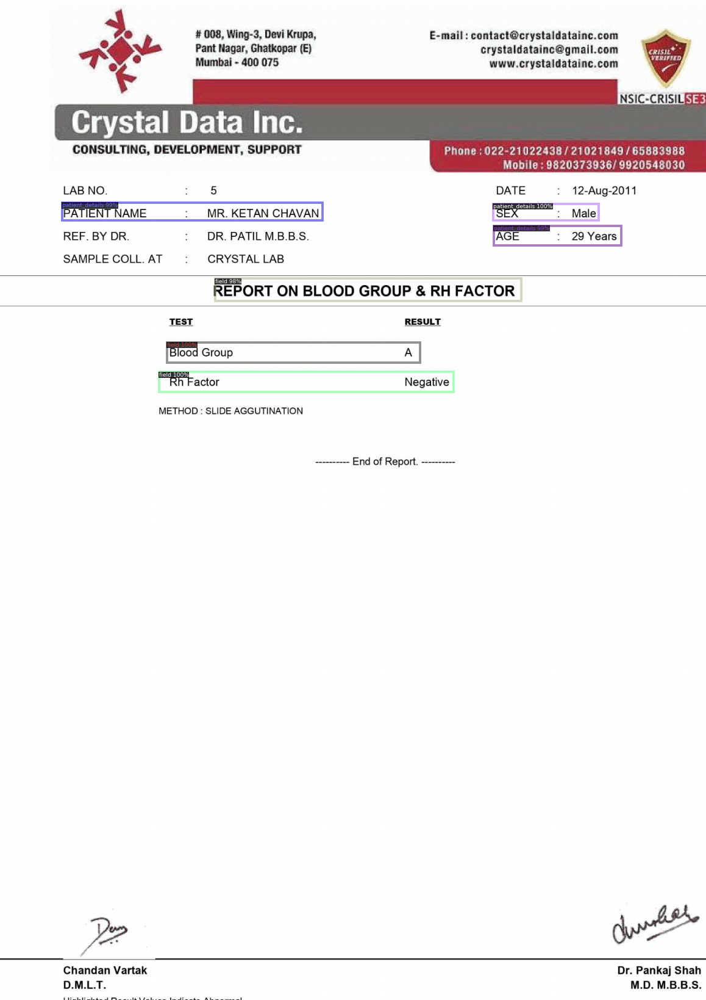

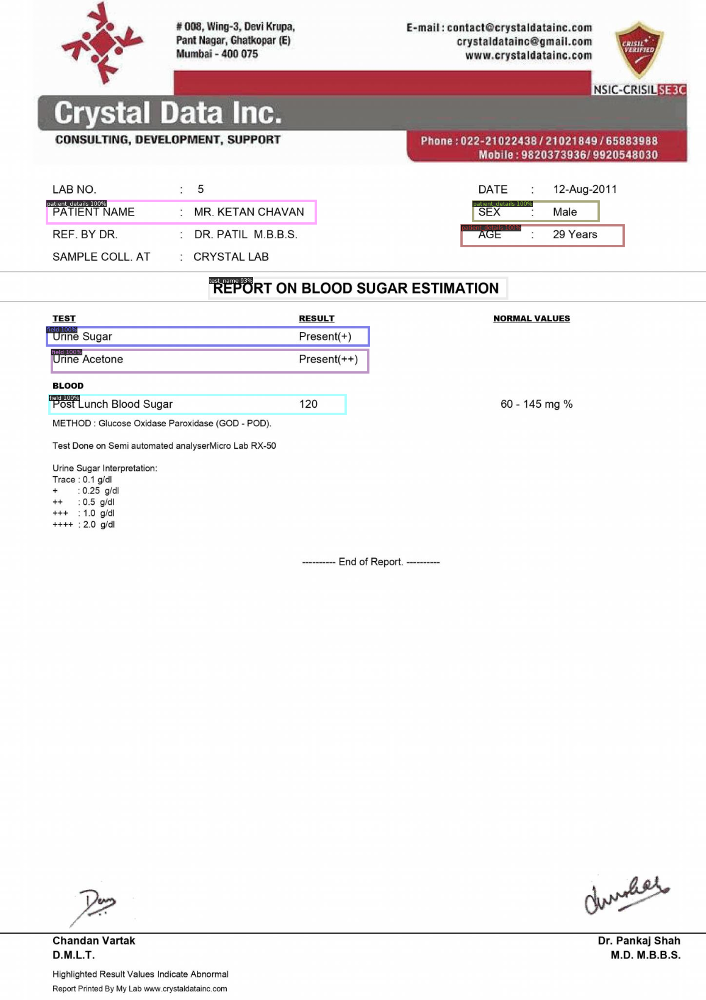

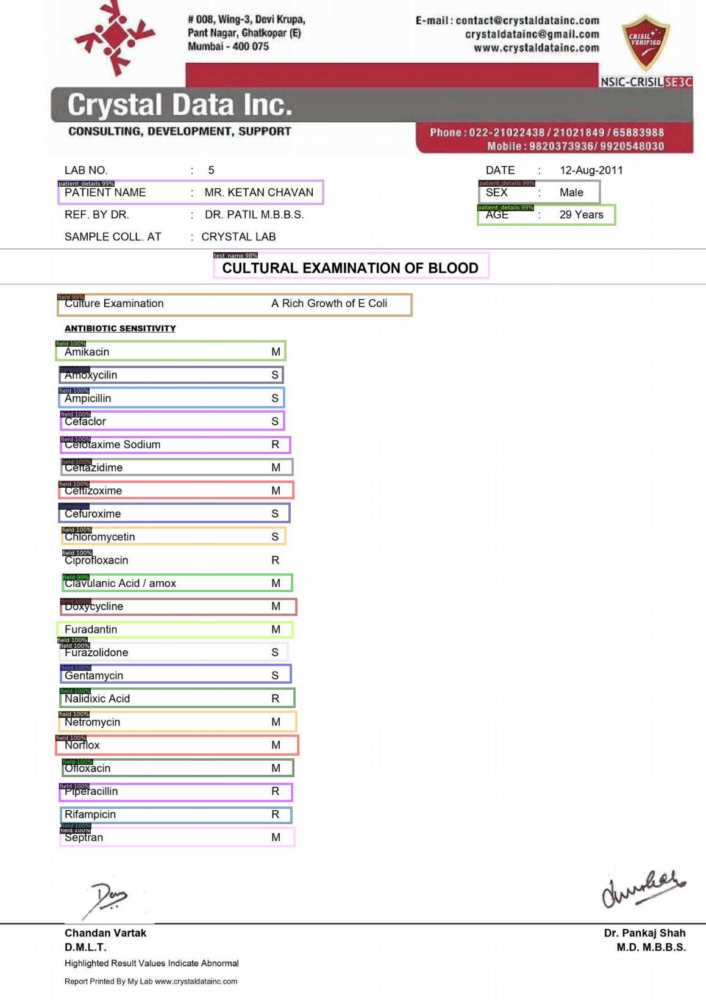

...

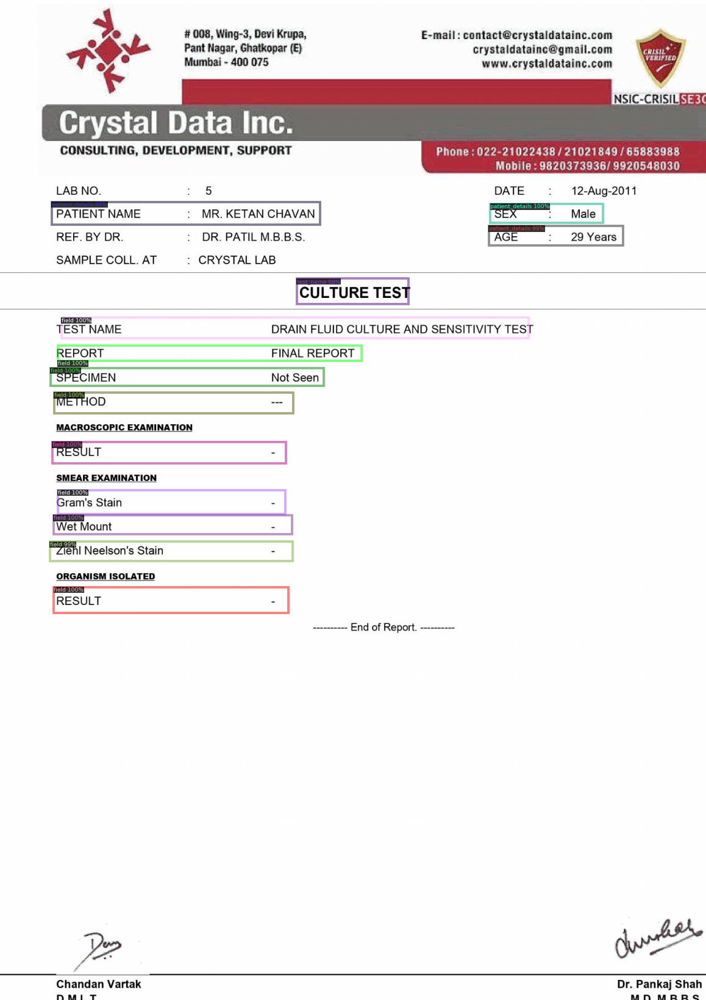

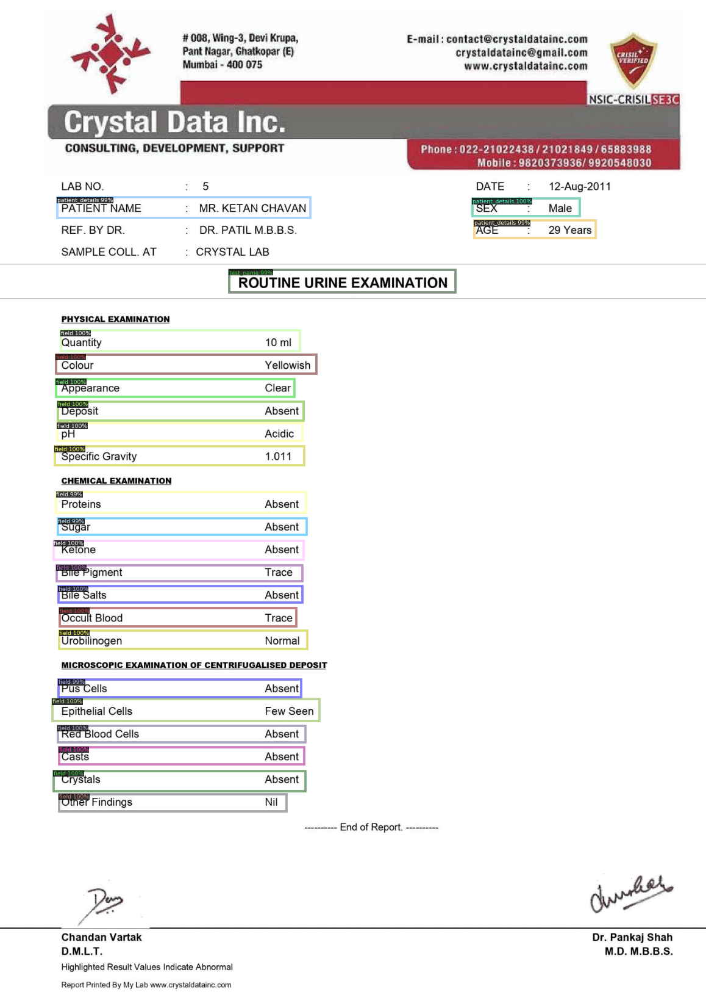

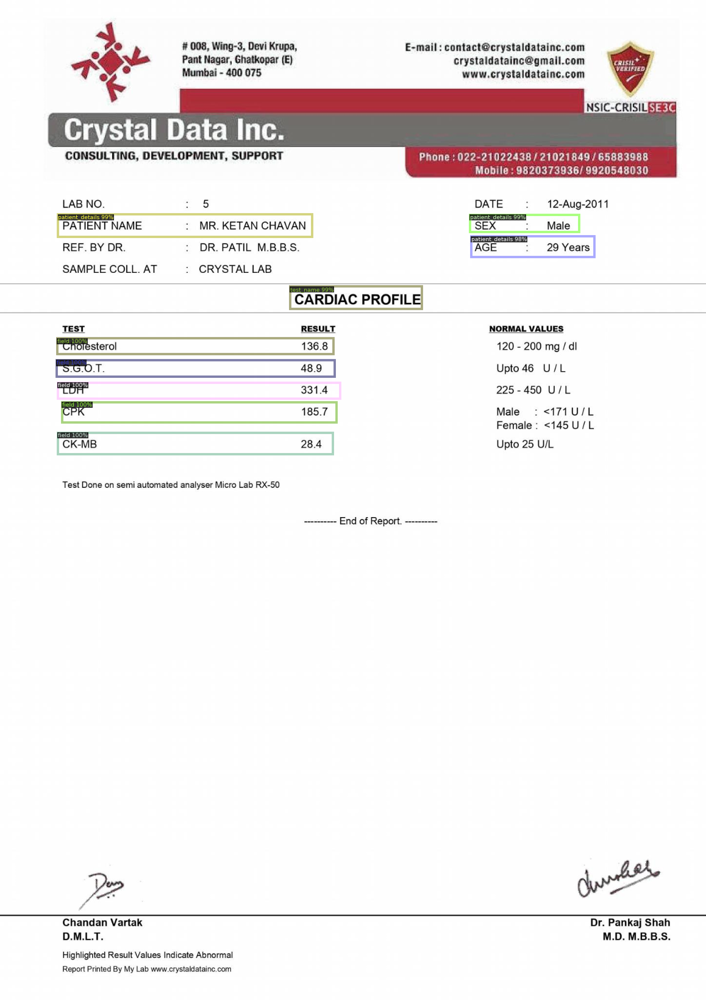

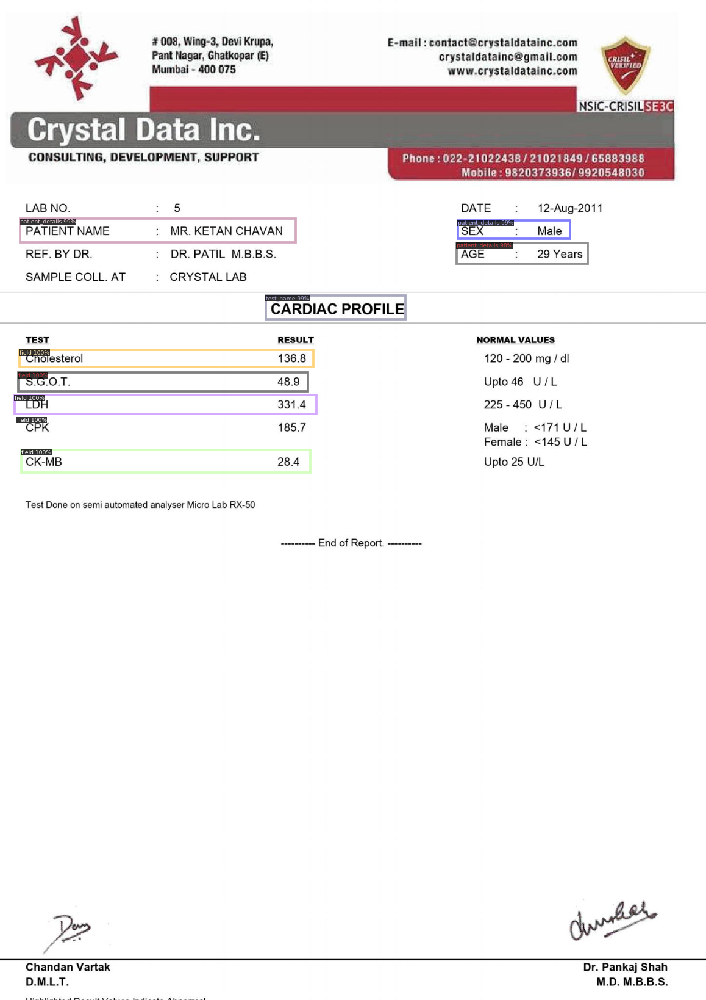

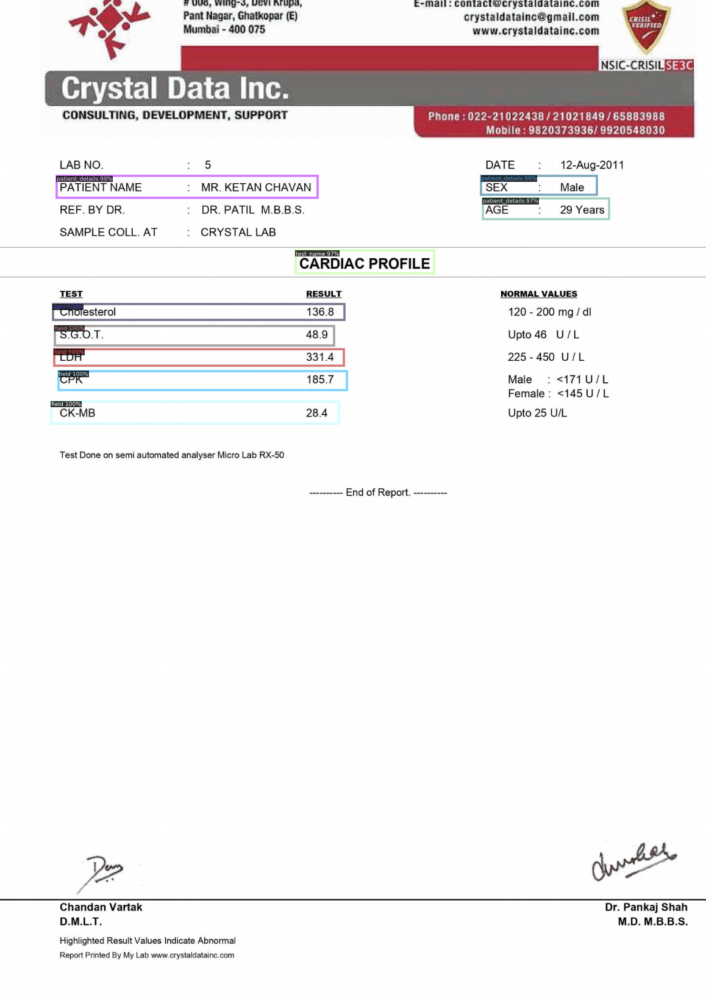

KeyboardInterrupt: ignored

In [158]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/train/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=my_dataset_train_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [125]:
res = {}

In [126]:
for j in range(1,4):
  res[j] = (outputs['instances'][outputs['instances'].pred_classes==j].pred_boxes.tensor.cpu().numpy())

In [127]:
len(res)

3

In [140]:
res

{1: array([[ 116.74483 ,  640.97174 ,  641.28156 ,  677.52234 ],
        [ 127.67396 , 1193.7229  ,  640.8139  , 1227.9055  ],
        [ 128.63908 , 1157.651   ,  636.0525  , 1187.2183  ],
        [ 124.01595 , 1123.4647  ,  637.08875 , 1153.2653  ],
        [ 125.648285, 1006.08514 ,  649.87994 , 1043.633   ],
        [ 118.66014 , 1048.8367  ,  639.9937  , 1079.8792  ],
        [ 125.56499 , 1085.4773  ,  641.56793 , 1115.7314  ],
        [ 123.33439 ,  703.3768  ,  642.5596  ,  738.4693  ],
        [ 126.60358 ,  817.7792  ,  662.51733 ,  853.298   ],
        [ 116.62259 ,  932.3549  ,  646.2862  ,  964.1622  ],
        [ 585.09906 ,  894.78784 , 1104.8563  ,  927.6121  ],
        [ 140.63895 ,  746.50775 ,  642.4151  ,  776.9821  ],
        [ 117.22492 ,  892.5636  ,  671.70984 ,  927.4799  ],
        [ 125.39433 ,  860.2529  ,  673.427   ,  891.2552  ],
        [ 130.55962 , 1267.245   ,  698.1709  , 1302.3868  ],
        [ 613.25085 ,  931.2949  , 1091.4413  ,  965.7903  ],
     

In [93]:
import pytesseract

In [79]:
from PIL import Image

In [148]:
im1 = Image.open(r"/content/train/BLOOD-SUGAR-FOR-FASTING_jpg.rf.2590e771bb6a257ef0f0c6b022f9bfd0.jpg")

In [155]:
im1 = cv2.imread("/content/train/BLOOD-SUGAR-FOR-FASTING_jpg.rf.2590e771bb6a257ef0f0c6b022f9bfd0.jpg")

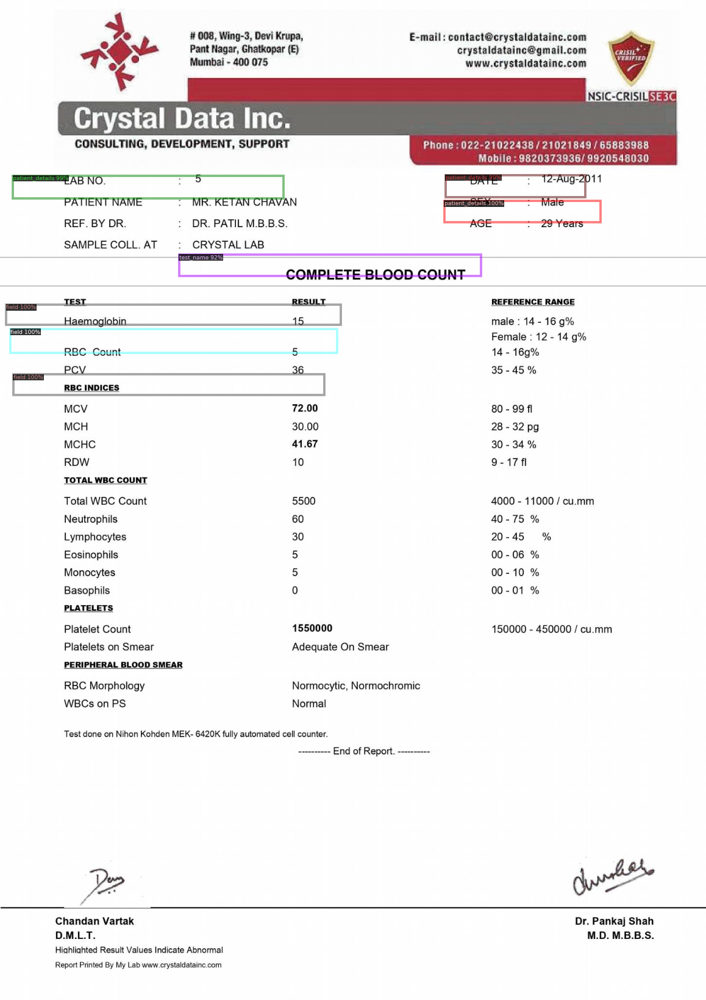

In [156]:
outputs = predictor(im1)
v = Visualizer(im[:, :, ::-1],
                metadata=my_dataset_train_metadata, 
                scale=0.8
                 )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [157]:
outputs["instances"]

Instances(num_instances=7, image_height=2048, image_width=1448, fields=[pred_boxes: Boxes(tensor([[  27.5337,  768.0069,  664.4902,  810.2467],
        [ 911.2452,  412.5128, 1231.6656,  456.3874],
        [  21.5749,  675.1409,  691.5722,  723.2531],
        [  12.9248,  625.0501,  698.8380,  666.5517],
        [ 913.5534,  359.7374, 1199.6949,  405.0377],
        [  26.5658,  361.0455,  581.6287,  407.8225],
        [ 367.3171,  522.7376,  986.8419,  565.7550]])), scores: tensor([0.9969, 0.9966, 0.9962, 0.9952, 0.9950, 0.9922, 0.9175]), pred_classes: tensor([1, 2, 1, 1, 2, 2, 3])])

In [150]:
for i in range(1,4):
  for v in res[i]:
    print(v)
    im_new =  im1.crop(v[0:])
    text = pytesseract.image_to_string(im_new, config="--oem 3 --psm 7")
    print(text)

[116.74483 640.97174 641.28156 677.52234]
Agar FTesenn

[ 127.67396 1193.7229   640.8139  1227.9055 ]
7 = = =

[ 128.63908 1157.651    636.0525  1187.2183 ]
Bn

[ 124.01595 1123.4647   637.08875 1153.2653 ]
Bn

[ 125.648285 1006.08514   649.87994  1043.633   ]
Bn

[ 118.66014 1048.8367   639.9937  1079.8792 ]

[ 125.56499 1085.4773   641.56793 1115.7314 ]
a a BS

[123.33439 703.3768  642.5596  738.4693 ]
7

[126.60358 817.7792  662.51733 853.298  ]
Glucose Oxidase Paroxidase (GOD - POD).

[116.62259 932.3549  646.2862  964.1622 ]
Oe

[ 585.09906  894.78784 1104.8563   927.6121 ]
re

[140.63895 746.50775 642.4151  776.9821 ]
Bn

[117.22492 892.5636  671.70984 927.4799 ]
a

[125.39433 860.2529  673.427   891.2552 ]
on Semi automated analyserMicro Lab RX-50

[ 130.55962 1267.245    698.1709  1302.3868 ]
a a

[ 613.25085  931.2949  1091.4413   965.7903 ]
OS

[ 602.2611 1049.6393 1139.5457 1079.7195]

[ 589.68494 1085.0769  1139.4401  1116.76   ]
a a BS

[ 593.4094 1121.11

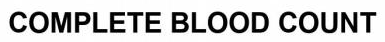

In [145]:
im_new

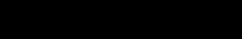

In [138]:
im1

In [114]:
text = pytesseract.image_to_string(im1, config="--oem 3 --psm 7")

In [115]:
text

'SEX : Male\n\x0c'

In [100]:
print(text)

COMPLETE BLOOD COUNT

